#Best Artworks of All Time - Generative Adversarial Networks (GANs) Project
#### Collection of Paintings of the 50 Most Influential Artists of All Time

####About Dataset:

This dataset contains three files:

* `artists.csv`: dataset of information for each artist
* `images.zip`: collection of images (full size), divided in folders and sequentially numbered
* `resized.zip`: same collection but images have been resized and extracted from folder structure.
Use `resized.zip` allows you to download less data and process faster your model.

##Download and Explore the Dataset

Using `opendatasets` and download the dataset from [Best Arworks of All Time](https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time)

In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset_url = 'https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time'

In [ ]:
od.download(dataset_url)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: laveshk314
Your Kaggle Key: ··········


100%|██████████| 2.29G/2.29G [00:23<00:00, 105MB/s]

In [ ]:
import os

In [ ]:
data_dir = './best-artworks-of-all-time/resized'

In [ ]:
os.listdir(data_dir + '/resized')[:10]

['Francisco_Goya_95.jpg',
 'Piet_Mondrian_32.jpg',
 'Albrecht_Du╠êrer_40.jpg',
 'Vincent_van_Gogh_148.jpg',
 'Edgar_Degas_183.jpg',
 'Francisco_Goya_179.jpg',
 'Hieronymus_Bosch_111.jpg',
 'Pierre-Auguste_Renoir_74.jpg',
 'Edgar_Degas_359.jpg',
 'Rembrandt_262.jpg']

In [ ]:
len(os.listdir(data_dir + '/resized'))

8683

### Import the dataset into PyTorch




In [ ]:
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.transforms as T

In [ ]:
image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [ ]:
train_ds = ImageFolder(data_dir, transform=T.Compose([T.Resize(image_size),
                                                     T.CenterCrop(image_size),
                                                     T.ToTensor(),
                                                     T.Normalize(*stats)]))
train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)

Let's create helper functions to denormalize the image tensors and display some sample images from a training batch

In [ ]:
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def denorm(img_tensors):
    return img_tensors*stats[1][0] + stats[0][0]

def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8,8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

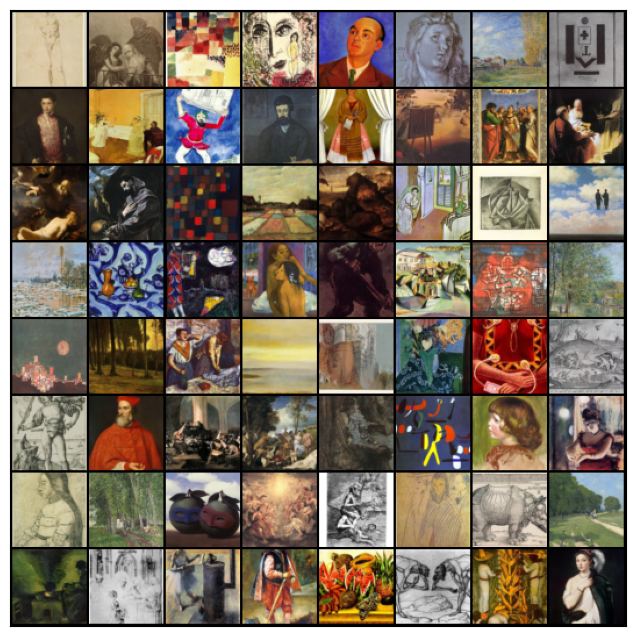

In [ ]:
show_batch(train_dl)

##Using a GPU

In [ ]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')

def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to( device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [ ]:
device = get_default_device()
device

device(type='cuda')

In [ ]:
train_dl = DeviceDataLoader(train_dl, device)

## Discriminator Network

The discriminator takes an image as input, and tries to classify it as "real" or "generated"

In [ ]:
import torch.nn as nn

In [ ]:
from torch.nn.modules.activation import LeakyReLU
from torch.nn.modules.batchnorm import BatchNorm2d

In [ ]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x  32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

Let's move the discriminator to the chosen device

In [ ]:
discriminator = to_device(discriminator, device)

##Generator Network

The input to the generator is typically a vector or a matrix of random numbers (referred to as a latent tensor) which is used as a seed for generating an image. The generator will convert a latent tensor of shape (128, 1, 1) into an image tensor of shape 3 x 64 x 64. To achive this, we'll use the `ConvTranspose2d` layer from PyTorch, which is performs to as a transposed convolution (also referred to as a deconvolution).

In [ ]:
latent_size = 128

In [ ]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64,  kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
    )

We used Tanh activation function for output layer of generator, bacause it always lie in range of `[-1, 1]`

Let's generate some outputs using the generator and view them as images by transforming and denormalizing the output.

torch.Size([128, 3, 64, 64])


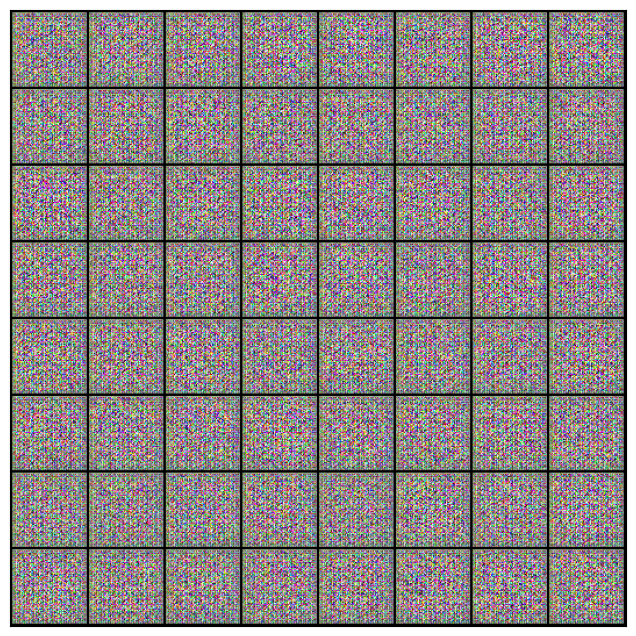

In [ ]:
xb = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images)

Let's move the generator to the chosen device

In [ ]:
generator = to_device(generator, device)

## Discriminator Training

In [ ]:
import torch.nn.functional as F

In [ ]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()

    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

It's important to note that we don't change the weights of the generator model while training the discriminator (opt_d only affects the `discriminator.parameters()`)

## Generator Training

In [ ]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()

    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(fake_images.size(0), 1, device=device)
    loss =  F.binary_cross_entropy(preds, targets)

    # Update generator weights
    loss.backward()
    opt_g.step()

    return loss.item()

Let's create a directory where we can save intermediate outputs from the generator to visually inspect the progress of the model. We'll also create a helper function to export the generated images.

In [ ]:
from torchvision.utils import save_image

sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [ ]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1,2,0))

We'll use a fixed set of input vectors to the generator to see how the individual generated images evolve over time as we train the model. Let's save one set of images before we start training our model.

In [ ]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

Saving generated-images-0000.png


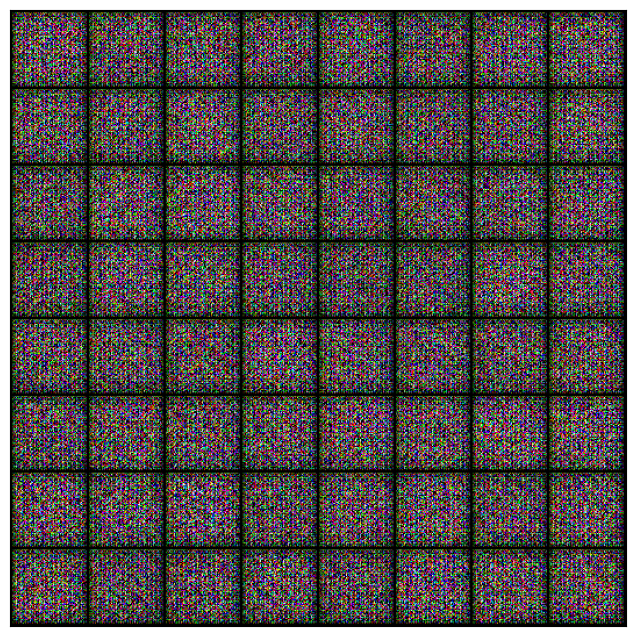

In [ ]:
save_samples(0, fixed_latent)

### Full Training Loop

Let's define a `fit` function to train the discriminator and generator in tandem for each batch of training data. We'll use the Adam optimizer with some custom parameters (betas) that are known to work well for GANs. We will also save some sample generated images at regular intervals for inspection.

In [ ]:
from tqdm.notebook import tqdm

In [ ]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()

    # Losses and scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    # Create optimizers
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
           # Train discriminator
           loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
           # Train Generator
           loss_g = train_generator(opt_g)

        # Record losses and scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)

        # Log the losses and scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)

    return losses_g, losses_d, real_scores, fake_scores

We are now ready to train the model. Try different learning rates to see if you can maintain the fine balance between the training the generator and the discriminator.

In [ ]:
lr = 0.0002
epochs = 25

In [ ]:
history = fit(epochs, lr)

  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [1/25], loss_g: 7.3504, loss_d: 0.3562, real_score: 0.9343, fake_score: 0.2418
Saving generated-images-0001.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [2/25], loss_g: 4.4660, loss_d: 0.2622, real_score: 0.9499, fake_score: 0.1861
Saving generated-images-0002.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [3/25], loss_g: 2.0844, loss_d: 0.4705, real_score: 0.7663, fake_score: 0.1566
Saving generated-images-0003.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [4/25], loss_g: 4.1614, loss_d: 0.9362, real_score: 0.7499, fake_score: 0.4438
Saving generated-images-0004.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [5/25], loss_g: 1.7248, loss_d: 1.4362, real_score: 0.2972, fake_score: 0.0185
Saving generated-images-0005.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [6/25], loss_g: 4.0656, loss_d: 0.3381, real_score: 0.9217, fake_score: 0.2137
Saving generated-images-0006.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [7/25], loss_g: 3.0124, loss_d: 0.5131, real_score: 0.8176, fake_score: 0.2392
Saving generated-images-0007.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [8/25], loss_g: 2.1953, loss_d: 0.9531, real_score: 0.4816, fake_score: 0.0695
Saving generated-images-0008.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [9/25], loss_g: 3.5314, loss_d: 0.3110, real_score: 0.8483, fake_score: 0.1250
Saving generated-images-0009.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [10/25], loss_g: 2.4980, loss_d: 1.0609, real_score: 0.5947, fake_score: 0.3371
Saving generated-images-0010.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [11/25], loss_g: 1.8516, loss_d: 0.5237, real_score: 0.8061, fake_score: 0.2136
Saving generated-images-0011.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [12/25], loss_g: 3.3884, loss_d: 0.3414, real_score: 0.8192, fake_score: 0.1114
Saving generated-images-0012.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [13/25], loss_g: 2.0893, loss_d: 0.5932, real_score: 0.6728, fake_score: 0.1243
Saving generated-images-0013.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [14/25], loss_g: 3.2257, loss_d: 0.4861, real_score: 0.7466, fake_score: 0.1430
Saving generated-images-0014.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [15/25], loss_g: 4.3793, loss_d: 0.6386, real_score: 0.8508, fake_score: 0.3278
Saving generated-images-0015.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [16/25], loss_g: 2.6807, loss_d: 0.5336, real_score: 0.7285, fake_score: 0.1664
Saving generated-images-0016.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [17/25], loss_g: 3.0305, loss_d: 0.9718, real_score: 0.4592, fake_score: 0.0427
Saving generated-images-0017.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [18/25], loss_g: 4.5968, loss_d: 0.5660, real_score: 0.8605, fake_score: 0.3128
Saving generated-images-0018.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [19/25], loss_g: 4.4810, loss_d: 0.2702, real_score: 0.9117, fake_score: 0.1471
Saving generated-images-0019.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [20/25], loss_g: 2.7303, loss_d: 0.6443, real_score: 0.7670, fake_score: 0.2537
Saving generated-images-0020.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [21/25], loss_g: 2.7182, loss_d: 0.5812, real_score: 0.6916, fake_score: 0.1321
Saving generated-images-0021.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [22/25], loss_g: 3.8328, loss_d: 0.4503, real_score: 0.8318, fake_score: 0.2019
Saving generated-images-0022.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [23/25], loss_g: 4.1121, loss_d: 0.5266, real_score: 0.7800, fake_score: 0.2036
Saving generated-images-0023.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [24/25], loss_g: 3.2586, loss_d: 0.6588, real_score: 0.5789, fake_score: 0.0217
Saving generated-images-0024.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [25/25], loss_g: 3.7766, loss_d: 0.5460, real_score: 0.8019, fake_score: 0.2505
Saving generated-images-0025.png


In [ ]:
losses_g, losses_d, real_scores, fake_scores = history

ValueError: ignored

Now that we have trained the models, we can save checkpoints.

In [ ]:
# Save the model checkpoints
torch.save(generator.state_dict(), 'G.pth')
torch.save(discriminator.state_dict(), 'D.pth')

In [ ]:
from IPython.display import Image

In [ ]:
Image('./generated/generated-images-0001.png')

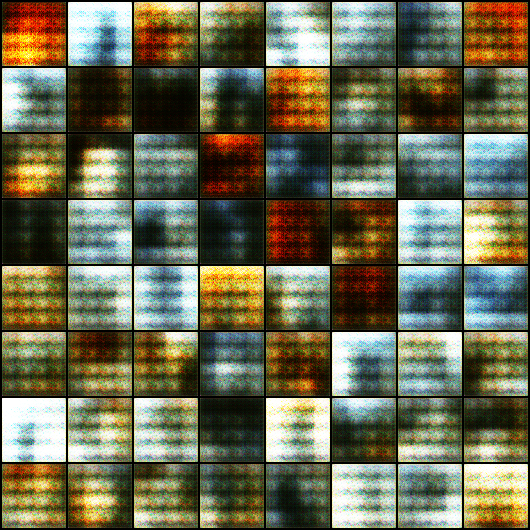

In [ ]:
Image('./generated/generated-images-0005.png')

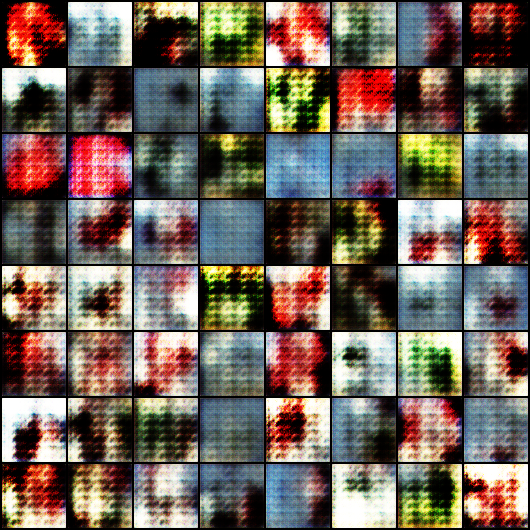

In [ ]:
Image('./generated/generated-images-0010.png')

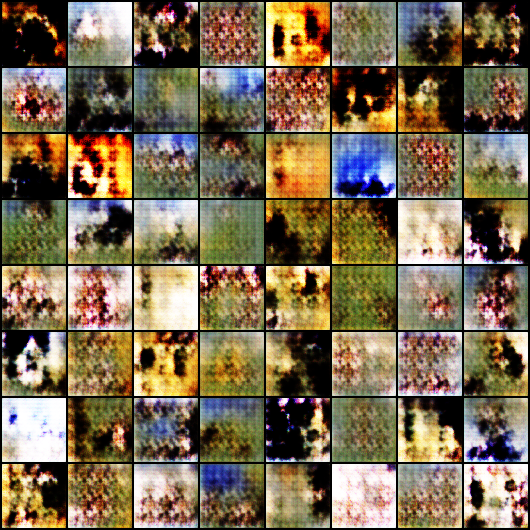

In [ ]:
Image('./generated/generated-images-0015.png')

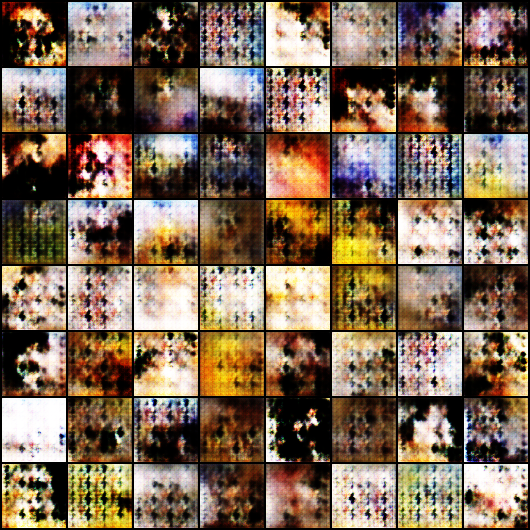

In [ ]:
Image('./generated/generated-images-0020.png')

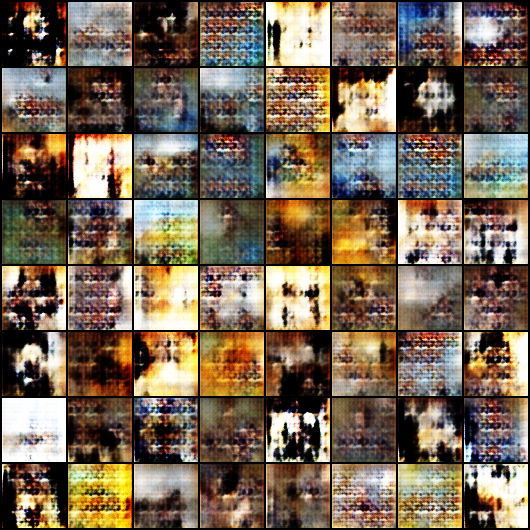

In [ ]:
Image('./generated/generated-images-0025.png')

In [ ]:
history += fit(25, 0.001)

  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [1/25], loss_g: 3.2929, loss_d: 1.2015, real_score: 0.5722, fake_score: 0.4122
Saving generated-images-0001.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [2/25], loss_g: 2.7489, loss_d: 0.5180, real_score: 0.7122, fake_score: 0.1228
Saving generated-images-0002.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [3/25], loss_g: 1.8395, loss_d: 0.8355, real_score: 0.5830, fake_score: 0.1751
Saving generated-images-0003.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [4/25], loss_g: 4.6500, loss_d: 0.8575, real_score: 0.8635, fake_score: 0.4629
Saving generated-images-0004.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [5/25], loss_g: 6.8663, loss_d: 1.7775, real_score: 0.9361, fake_score: 0.7687
Saving generated-images-0005.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [6/25], loss_g: 3.5149, loss_d: 0.7153, real_score: 0.8066, fake_score: 0.3468
Saving generated-images-0006.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [7/25], loss_g: 3.4486, loss_d: 1.2829, real_score: 0.5890, fake_score: 0.4626
Saving generated-images-0007.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [8/25], loss_g: 2.0458, loss_d: 0.7881, real_score: 0.6152, fake_score: 0.1950
Saving generated-images-0008.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [9/25], loss_g: 2.0779, loss_d: 0.6224, real_score: 0.6032, fake_score: 0.0438
Saving generated-images-0009.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [10/25], loss_g: 2.4400, loss_d: 1.0240, real_score: 0.6069, fake_score: 0.3219
Saving generated-images-0010.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [11/25], loss_g: 0.9911, loss_d: 1.7584, real_score: 0.2605, fake_score: 0.1288
Saving generated-images-0011.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [12/25], loss_g: 2.5614, loss_d: 0.7076, real_score: 0.6699, fake_score: 0.1945
Saving generated-images-0012.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [13/25], loss_g: 2.2948, loss_d: 0.6349, real_score: 0.7076, fake_score: 0.2047
Saving generated-images-0013.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [14/25], loss_g: 4.8616, loss_d: 1.3468, real_score: 0.8252, fake_score: 0.6121
Saving generated-images-0014.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [15/25], loss_g: 4.2930, loss_d: 0.9924, real_score: 0.8415, fake_score: 0.4839
Saving generated-images-0015.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [16/25], loss_g: 2.0406, loss_d: 0.7044, real_score: 0.8370, fake_score: 0.3664
Saving generated-images-0016.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [17/25], loss_g: 2.0430, loss_d: 1.2449, real_score: 0.3823, fake_score: 0.0334
Saving generated-images-0017.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [18/25], loss_g: 3.5689, loss_d: 1.2222, real_score: 0.9147, fake_score: 0.5910
Saving generated-images-0018.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [19/25], loss_g: 3.9328, loss_d: 0.9173, real_score: 0.8340, fake_score: 0.4574
Saving generated-images-0019.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [20/25], loss_g: 3.7051, loss_d: 1.1808, real_score: 0.9201, fake_score: 0.6042
Saving generated-images-0020.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [21/25], loss_g: 1.8795, loss_d: 0.9930, real_score: 0.5906, fake_score: 0.2763
Saving generated-images-0021.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [22/25], loss_g: 4.4774, loss_d: 1.0233, real_score: 0.8860, fake_score: 0.5404
Saving generated-images-0022.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [23/25], loss_g: 0.9276, loss_d: 1.8563, real_score: 0.2262, fake_score: 0.0303
Saving generated-images-0023.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [24/25], loss_g: 4.3151, loss_d: 0.7264, real_score: 0.9269, fake_score: 0.4267
Saving generated-images-0024.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [25/25], loss_g: 5.0431, loss_d: 1.0639, real_score: 0.8901, fake_score: 0.5560
Saving generated-images-0025.png


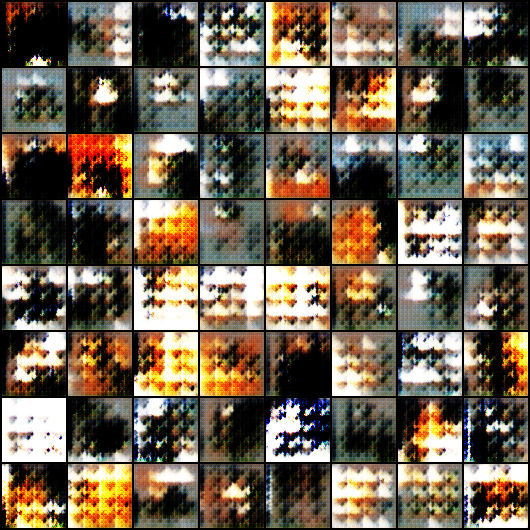

In [ ]:
Image('./generated/generated-images-0001.png')

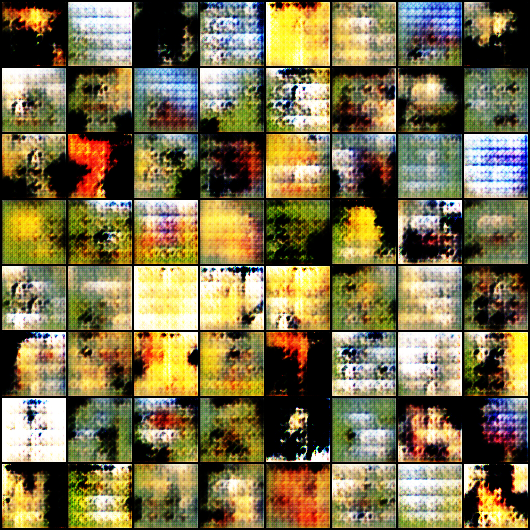

In [ ]:
Image('./generated/generated-images-0005.png')

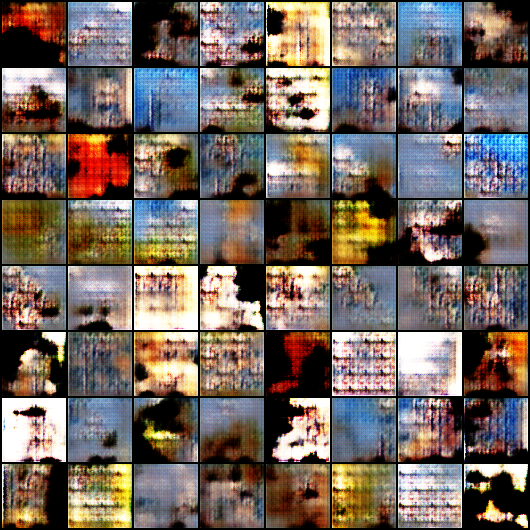

In [ ]:
Image('./generated/generated-images-0010.png')

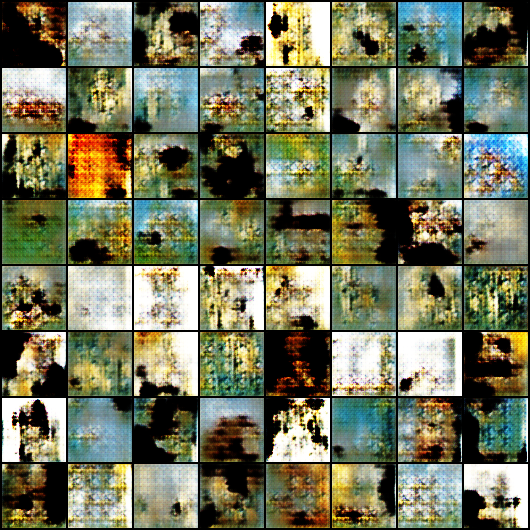

In [ ]:
Image('./generated/generated-images-0015.png')

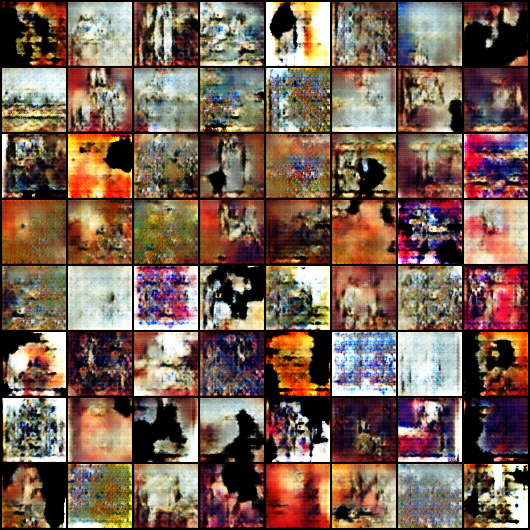

In [ ]:
Image('./generated/generated-images-0025.png')

In [ ]:
history += fit(10, 0.0005)

  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [1/10], loss_g: 2.7411, loss_d: 0.5452, real_score: 0.9125, fake_score: 0.3271
Saving generated-images-0001.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [2/10], loss_g: 4.4052, loss_d: 0.4291, real_score: 0.9253, fake_score: 0.2682
Saving generated-images-0002.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [3/10], loss_g: 4.0989, loss_d: 0.4641, real_score: 0.9139, fake_score: 0.2763
Saving generated-images-0003.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [4/10], loss_g: 6.5224, loss_d: 0.5480, real_score: 0.9513, fake_score: 0.3588
Saving generated-images-0004.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [5/10], loss_g: 1.8581, loss_d: 0.4871, real_score: 0.7082, fake_score: 0.0678
Saving generated-images-0005.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [6/10], loss_g: 4.0014, loss_d: 0.3274, real_score: 0.9163, fake_score: 0.1913
Saving generated-images-0006.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [7/10], loss_g: 1.9732, loss_d: 0.3697, real_score: 0.8771, fake_score: 0.1695
Saving generated-images-0007.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [8/10], loss_g: 7.5043, loss_d: 1.4647, real_score: 0.9867, fake_score: 0.6985
Saving generated-images-0008.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [9/10], loss_g: 0.8926, loss_d: 0.6492, real_score: 0.5867, fake_score: 0.0248
Saving generated-images-0009.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [10/10], loss_g: 1.7462, loss_d: 0.7739, real_score: 0.5435, fake_score: 0.0211
Saving generated-images-0010.png


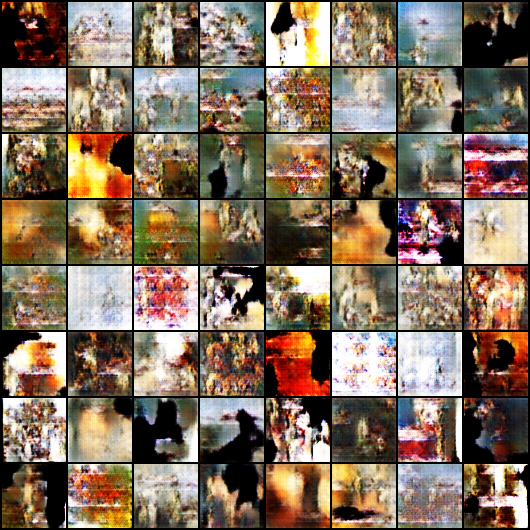

In [ ]:
Image('./generated/generated-images-0001.png')

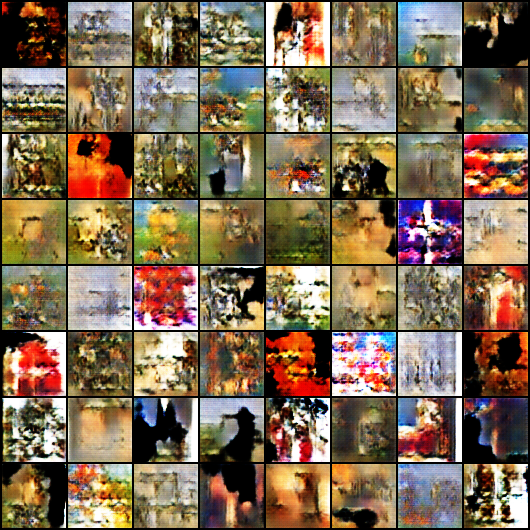

In [ ]:
Image('./generated/generated-images-0005.png')

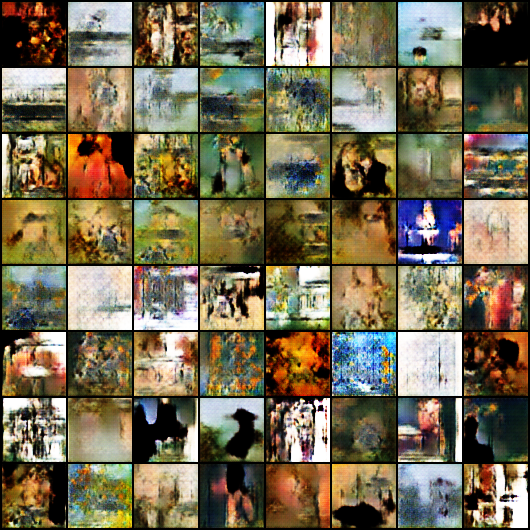

In [ ]:
Image('./generated/generated-images-0010.png')

In [ ]:
history += fit(10, 0.0005)

  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [1/10], loss_g: 5.8594, loss_d: 0.4623, real_score: 0.9133, fake_score: 0.2588
Saving generated-images-0001.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [2/10], loss_g: 4.0450, loss_d: 0.7267, real_score: 0.5676, fake_score: 0.0028
Saving generated-images-0002.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [3/10], loss_g: 0.7436, loss_d: 1.1085, real_score: 0.4069, fake_score: 0.0058
Saving generated-images-0003.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [4/10], loss_g: 3.6784, loss_d: 0.4390, real_score: 0.9164, fake_score: 0.2591
Saving generated-images-0004.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [5/10], loss_g: 5.5537, loss_d: 0.6764, real_score: 0.9613, fake_score: 0.3922
Saving generated-images-0005.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [6/10], loss_g: 3.7448, loss_d: 0.6115, real_score: 0.6101, fake_score: 0.0155
Saving generated-images-0006.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [7/10], loss_g: 2.3421, loss_d: 0.5498, real_score: 0.6258, fake_score: 0.0079
Saving generated-images-0007.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [8/10], loss_g: 2.4957, loss_d: 0.5414, real_score: 0.7423, fake_score: 0.1676
Saving generated-images-0008.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [9/10], loss_g: 4.2920, loss_d: 0.4070, real_score: 0.8563, fake_score: 0.1849
Saving generated-images-0009.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [10/10], loss_g: 4.2581, loss_d: 0.1474, real_score: 0.9040, fake_score: 0.0368
Saving generated-images-0010.png


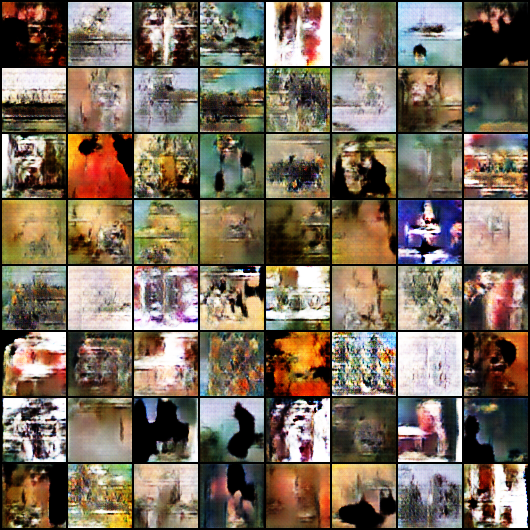

In [ ]:
Image('./generated/generated-images-0001.png')

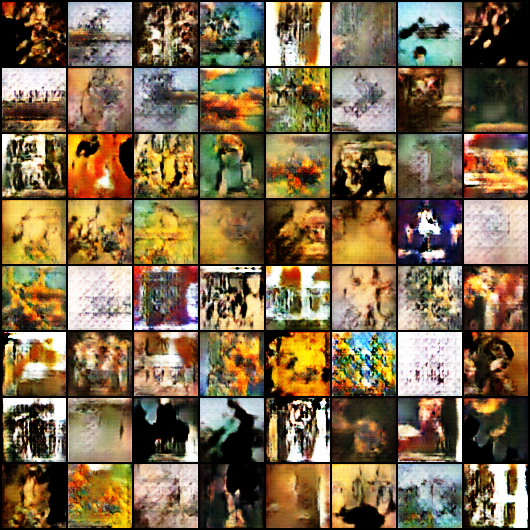

In [ ]:
Image('./generated/generated-images-0005.png')

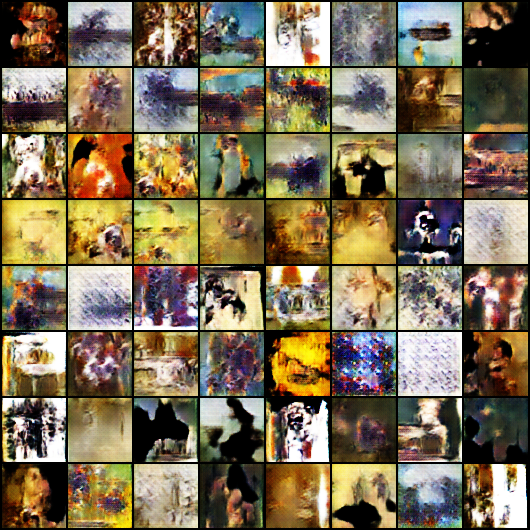

In [ ]:
Image('./generated/generated-images-0010.png')

In [ ]:
history += fit(20, 0.00005)

  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [1/20], loss_g: 3.6004, loss_d: 0.1659, real_score: 0.9036, fake_score: 0.0538
Saving generated-images-0001.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [2/20], loss_g: 3.8189, loss_d: 0.1883, real_score: 0.8748, fake_score: 0.0403
Saving generated-images-0002.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [3/20], loss_g: 4.5180, loss_d: 0.1082, real_score: 0.9175, fake_score: 0.0189
Saving generated-images-0003.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [4/20], loss_g: 4.2832, loss_d: 0.0306, real_score: 0.9983, fake_score: 0.0267
Saving generated-images-0004.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [5/20], loss_g: 4.3417, loss_d: 0.0605, real_score: 0.9604, fake_score: 0.0189
Saving generated-images-0005.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [6/20], loss_g: 5.1668, loss_d: 0.0494, real_score: 0.9899, fake_score: 0.0368
Saving generated-images-0006.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [7/20], loss_g: 4.4824, loss_d: 0.0625, real_score: 0.9847, fake_score: 0.0444
Saving generated-images-0007.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [8/20], loss_g: 5.3829, loss_d: 0.0279, real_score: 0.9836, fake_score: 0.0110
Saving generated-images-0008.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [9/20], loss_g: 4.5844, loss_d: 0.0405, real_score: 0.9889, fake_score: 0.0284
Saving generated-images-0009.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [10/20], loss_g: 4.7198, loss_d: 0.0249, real_score: 0.9913, fake_score: 0.0158
Saving generated-images-0010.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [11/20], loss_g: 4.7359, loss_d: 0.0957, real_score: 0.9203, fake_score: 0.0090
Saving generated-images-0011.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [12/20], loss_g: 4.5702, loss_d: 0.0336, real_score: 0.9942, fake_score: 0.0268
Saving generated-images-0012.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [13/20], loss_g: 5.7250, loss_d: 0.0168, real_score: 0.9942, fake_score: 0.0107
Saving generated-images-0013.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [14/20], loss_g: 5.8096, loss_d: 0.0196, real_score: 0.9963, fake_score: 0.0156
Saving generated-images-0014.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [15/20], loss_g: 4.5786, loss_d: 0.0391, real_score: 0.9802, fake_score: 0.0182
Saving generated-images-0015.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [16/20], loss_g: 5.2529, loss_d: 0.0169, real_score: 0.9974, fake_score: 0.0141
Saving generated-images-0016.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [17/20], loss_g: 4.6013, loss_d: 0.0243, real_score: 0.9966, fake_score: 0.0202
Saving generated-images-0017.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [18/20], loss_g: 5.3618, loss_d: 0.0482, real_score: 0.9663, fake_score: 0.0127
Saving generated-images-0018.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [19/20], loss_g: 5.3094, loss_d: 0.0244, real_score: 0.9973, fake_score: 0.0210
Saving generated-images-0019.png


  0%|          | 0/68 [00:00<?, ?it/s]

Epoch [20/20], loss_g: 4.3884, loss_d: 0.0324, real_score: 0.9776, fake_score: 0.0093
Saving generated-images-0020.png


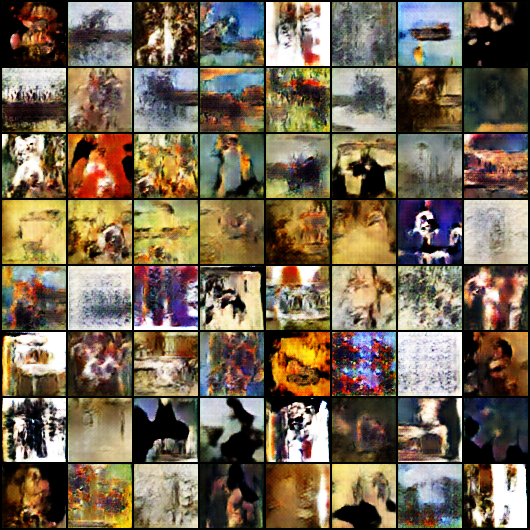

In [ ]:
Image('./generated/generated-images-0001.png')

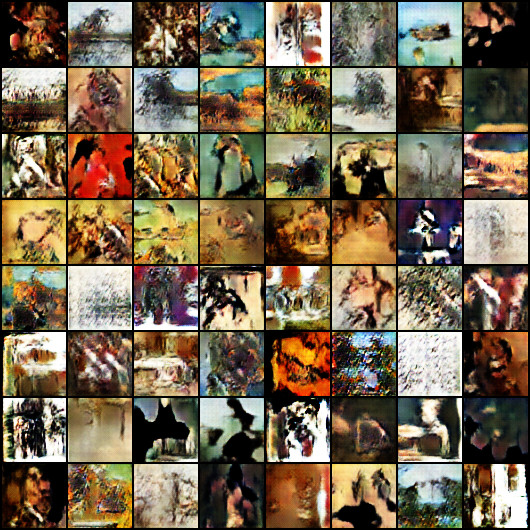

In [ ]:
Image('./generated/generated-images-0005.png')

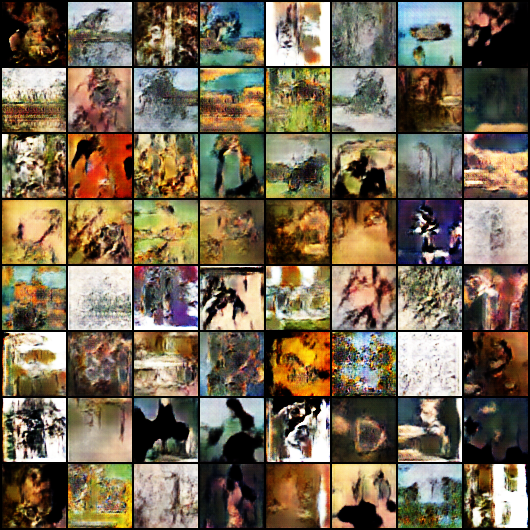

In [ ]:
Image('./generated/generated-images-0010.png')

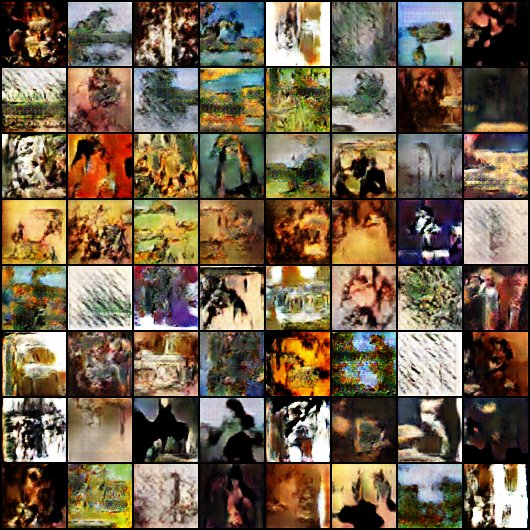

In [ ]:
Image('./generated/generated-images-0015.png')

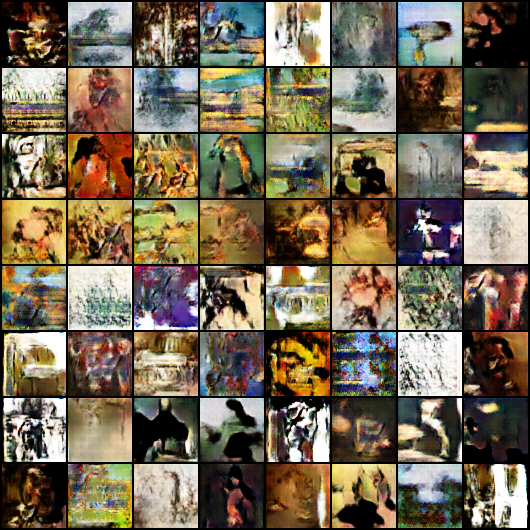

In [ ]:
Image('./generated/generated-images-0020.png')

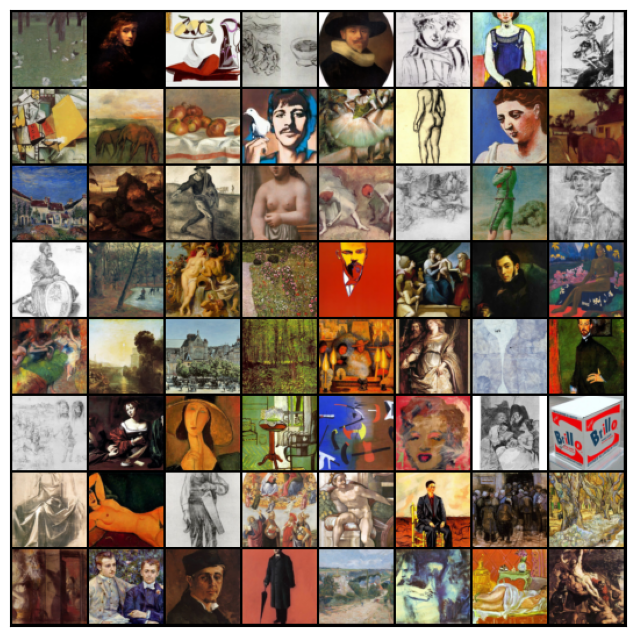

In [ ]:
show_batch(DeviceDataLoader(train_dl, 'cpu'))

We can also visualize how the loss changes over time. Visualizing losses is quite useful for debugging the training process. For GANs, we expect the generator's loss to reduce over time, without the discriminator's loss getting too high.

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

NameError: ignored

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

In [ ]:
!pip install jovian --upgrade --q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.6/68.6 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
import jovian

In [ ]:
# Save the model checkpoints
torch.save(generator.state_dict(), 'G.pth')
torch.save(discriminator.state_dict(), 'D.pth')

In [ ]:
project_name = 'deep-learning-GANs-project-artist-paintings'

In [ ]:
jovian.commit(project=project_name,
              outputs=['G.pth', 'D.pth'],
              environment=None)

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.
